<a href="https://colab.research.google.com/github/ismai-doc/Artificial-neural-network/blob/main/data_aug.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Test technique

## Génération des images 3D.

## Démarche :
*   Visualisation et prétraitement des données: 


*   Augementation des données en utilisant les techniques standard :
> Rotation.\
> Flipping.\
> Brightness.

---

# Importation des librairies

In [ ]:
# import the necessary packages
from tensorflow.keras.layers import Conv3D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras import Sequential
from tensorflow.keras.layers.experimental import preprocessing
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider, Button, RadioButtons
from scipy.ndimage.interpolation import affine_transform

import tensorflow as tf
import os

## Visualisation

In [ ]:
import numpy as np
import nibabel as nib
import scipy.ndimage

In [ ]:
# load data
sample = nib.load('data.nii')

### L'image Niftil contient deux parties : le header et l'image IRM.

In [ ]:
print(sample)

<class 'nibabel.nifti1.Nifti1Image'>
data shape (512, 512, 600)
affine: 
[[   0.97656202    0.            0.         -278.1000061 ]
 [   0.            0.97656202    0.         -238.69999695]
 [   0.            0.            0.79998779 -459.5249939 ]
 [   0.            0.            0.            1.        ]]
metadata:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 512 512 600   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : uint16
bitpix          : 16
slice_start     : 0
pixdim          : [1.        0.976562  0.976562  0.7999878 0.        0.        0.
 0.       ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 2
cal_max         : 0.0
cal_min         : 0

### vérifier les unités de voxels (comme nous pouvons le voir nous n'avons que des millimètres)

In [ ]:
sample.header.get_xyzt_units()

('mm', 'unknown')

In [ ]:

sample.affine

array([[   0.97656202,    0.        ,    0.        , -278.1000061 ],
       [   0.        ,    0.97656202,    0.        , -238.69999695],
       [   0.        ,    0.        ,    0.79998779, -459.5249939 ],
       [   0.        ,    0.        ,    0.        ,    1.        ]])

### Récupérer l'image

In [ ]:
data = sample.get_fdata()
data.shape

(512, 512, 600)

Les voxels ne sont isotropes 

In [ ]:
voxels_dim = sample.header.get_zooms()
voxels_dim

(0.976562, 0.976562, 0.7999878)

In [ ]:

# resampling of voxels 
def resample(data, old_spacing, new_spacing=[0.976562, 0.976562, 0.976562]):
    
    old_spacing = np.asarray(old_spacing)
    new_spacing = np.asarray(new_spacing)
    old_spacing = [round(i,2) for i in old_spacing]
    scale_factor = old_spacing / new_spacing
    
    new_shape = data.shape * scale_factor
    new_shape = np.round(new_shape)
    zoom_factor = new_shape / data.shape
    new_spacing = old_spacing / zoom_factor
    new_spacing = np.asarray(new_spacing)
    
    data = scipy.ndimage.zoom(data, zoom_factor, order=1, prefilter=True)
    return data


data = resample(data, [0.976562,  0.976562,  0.79998779])

print(data.shape)  


(514, 514, 492)


### Normalisation

In [ ]:
data = (data - data.min()) / (data.max() - data.min())

In [ ]:
data = data[116:426, 110:298, 0:270]
data.shape

(310, 188, 270)

### Visualisation 3D de l'image en utilisant "napari"

In [ ]:
import napari

# initialization napari GUI
napari.gui_qt()

# use qt gui
%gui qt

# create viewer 
viewer = napari.Viewer()

# add image
viewer.add_image(data)

<Image layer 'data' at 0x25fd49fe6d0>

### Resultat de la visualisation 3D

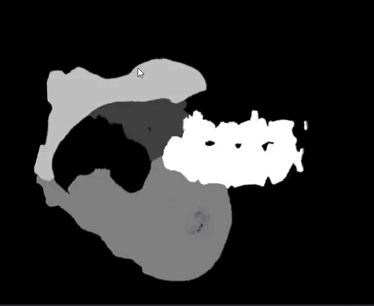

In [ ]:
from IPython.display import Image
Image('vue3D.gif')

In [ ]:
data.shape

(310, 188, 270)

### Visulation de l'image avec des sliders

<Figure size 432x288 with 0 Axes>

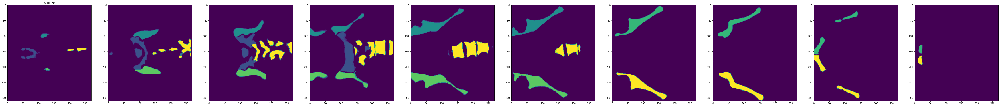

In [ ]:
class ArrayView(object):

    # xvalues: numpy 1D array of X values
    # functionToEvaluate should be in the form:
    # def gaussian(x, *args):
    #   m1, s1 = args
    #    ret = scipy.stats.norm.pdf(x, loc=m1, scale=s1) # x peut etre un array ici, pas forcement un scalaire
    #    return ret # renvoie un scalaire ou un array, suivant les cas
    # *functionArgs: function arguments
    # Example usage:
    # xvalues = np.linspace(-10.0, 10.0, 0.1)
    # yvalues = gaussian()
    # ArrayView.viewCurve(xvalues, yvalues)
    def viewCurve(xvalues, yvalues):
        plt.clf()
        plt.plot(xvalues, yvalues)

    def view2DArray(arr):
        plt.clf()
        plt.imshow(arr)
    
    # Ported from the Python2 code found in:
    # http://nbarbey.github.io/2011/07/08/matplotlib-slider.html
    # Changed:
    # xrange -> range
    # get rid of 'axisbg'
    # remove erroneous line breaks
    def view3DArray(cube, axis=1, **kwargs):
        # check dim
        if not cube.ndim == 4:
            raise ValueError("cube should be an ndarray with ndim == 4")

        if cube.shape[3] != 3:
            raise ValueError("cube's last dimension should be 3")
      
        minVal = np.min(cube)
        maxVal = np.max(cube)
    
        if minVal < 0.0 or maxVal > 1.0:
            raise ValueError("cube values cannot be outside the range [0,1]") 
        
        # generate figure
        fig = plt.figure()
        fig, (ax1, ax2 ,ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10) = plt.subplots(nrows=1, ncols=10, figsize=(80, 50))

        ax1.imshow(data[:, 20, :])
        ax1.set_title("Slide 20")
        ax2.imshow(data[:, 40, :])
        ax3.imshow(data[:, 60, :])
        ax4.imshow(data[:, 80, :])
        ax5.imshow(data[:, 100, :])
        ax6.imshow(data[:, 110, :])
        ax7.imshow(data[:, 120, :])
        ax8.imshow(data[:, 140, :])
        ax9.imshow(data[:, 160, :])
        ax10.imshow(data[:, 180, :])

        plt.show
        

if __name__ == "__main__":
    """
    #reshape
    data = data.reshape(data.shape[0], data.shape[1], data.shape[2], 1)
    print(data.shape)
    data_cube = np.append( data , data , axis = 3)
    data_cube = np.append( data_cube,  data , axis = 3)
    print(data_cube.shape)"""

    #visualization 3D
    ArrayView.view3DArray(data_cube)


### Vu avec des sliders (animation)

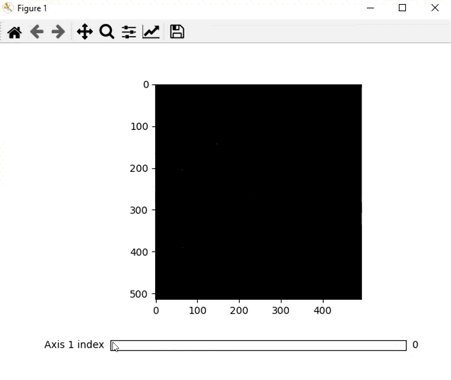

In [ ]:
from IPython.display import Image
Image('SliderView.gif')

## Augmentation des données

### Flipping

In [ ]:
def flip3D(X):
    """
    Flip the 3D image respect one of the 3 axis chosen randomly
    """
    choice = np.random.randint(3)
    if choice == 0: # flip on x
        X_flip = X[::-1, :, :]
    if choice == 1: # flip on y
        X_flip = X[:, ::-1, :]
    if choice == 2: # flip on z
        X_flip= X[:, :, ::-1]
    return X_flip

In [ ]:
data_flipped = flip3D(data)

(310, 188, 270, 1)
(310, 188, 270, 3)


<Figure size 432x288 with 0 Axes>

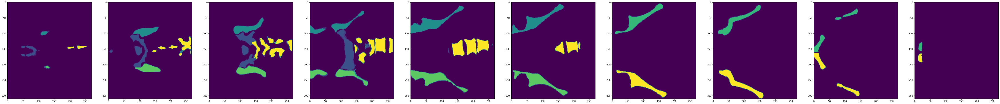

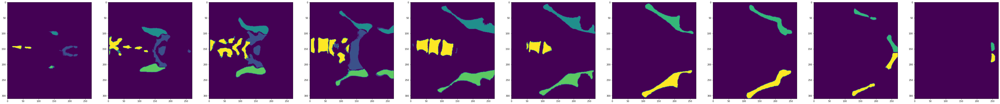

In [ ]:
class ArrayView(object):

    # xvalues: numpy 1D array of X values
    # functionToEvaluate should be in the form:
    # def gaussian(x, *args):
    #   m1, s1 = args
    #    ret = scipy.stats.norm.pdf(x, loc=m1, scale=s1) # x peut etre un array ici, pas forcement un scalaire
    #    return ret # renvoie un scalaire ou un array, suivant les cas
    # *functionArgs: function arguments
    # Example usage:
    # xvalues = np.linspace(-10.0, 10.0, 0.1)
    # yvalues = gaussian()
    # ArrayView.viewCurve(xvalues, yvalues)
    def viewCurve(xvalues, yvalues):
        plt.clf()
        plt.plot(xvalues, yvalues)

    def view2DArray(arr):
        plt.clf()
        plt.imshow(arr)
    
    # Ported from the Python2 code found in:
    # http://nbarbey.github.io/2011/07/08/matplotlib-slider.html
    # Changed:
    # xrange -> range
    # get rid of 'axisbg'
    # remove erroneous line breaks
    def view3DArray(cube, axis=1, **kwargs):
        # check dim
        if not cube.ndim == 4:
            raise ValueError("cube should be an ndarray with ndim == 4")

        if cube.shape[3] != 3:
            raise ValueError("cube's last dimension should be 3")
      
        minVal = np.min(cube)
        maxVal = np.max(cube)
    
        if minVal < 0.0 or maxVal > 1.0:
            raise ValueError("cube values cannot be outside the range [0,1]") 
        
        # generate figure
        fig = plt.figure()
        fig, (ax1, ax2 ,ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10) = plt.subplots(nrows=1, ncols=10, figsize=(80, 50))
        fig, (ax11, ax22 ,ax33, ax44, ax55, ax66, ax77, ax88, ax99, ax110) = plt.subplots(nrows=1, ncols=10, figsize=(80, 50))

        ax1.imshow(data[:, 20, :])
        ax2.imshow(data[:, 40, :])
        ax3.imshow(data[:, 60, :])
        ax4.imshow(data[:, 80, :])
        ax5.imshow(data[:, 100, :])
        ax6.imshow(data[:, 110, :])
        ax7.imshow(data[:, 120, :])
        ax8.imshow(data[:, 140, :])
        ax9.imshow(data[:, 160, :])
        ax10.imshow(data[:, 180, :])

        ax11.imshow(data_flipped[:, 20, :])
        ax22.imshow(data_flipped[:, 40, :])
        ax33.imshow(data_flipped[:, 60, :])
        ax44.imshow(data_flipped[:, 80, :])
        ax55.imshow(data_flipped[:, 100, :])
        ax66.imshow(data_flipped[:, 110, :])
        ax77.imshow(data_flipped[:, 120, :])
        ax88.imshow(data_flipped[:, 140, :])
        ax99.imshow(data_flipped[:, 160, :])
        ax110.imshow(data_flipped[:, 180, :])
        plt.show
        

if __name__ == "__main__":
 
    #reshape
    data = data.reshape(data.shape[0], data.shape[1], data.shape[2], 1)
    print(data.shape)
    data_cube = np.append( data , data , axis = 3)
    data_cube = np.append( data_cube,  data , axis = 3)
    print(data_cube.shape)

    """data_flipped = data_flipped.reshape(data.shape[0], data.shape[1], data.shape[2], 1)
    data_flipped_cube = np.append( data_flipped , data_flipped , axis = 3)
    data_flipped_cube = np.append( data_flipped_cube,  data_flipped , axis = 3)
    print(data_flipped_cube.shape)"""


    #visualization 3D
    ArrayView.view3DArray(data_cube)

In [ ]:
def rotation_zoom3D(X):
    """
    Rotate a 3D image with alfa, beta and gamma degree respect the axis x, y and z respectively.
    The three angles are chosen randomly between 0-30 degrees
    """
    alpha, beta, gamma = np.random.random_sample(3)*np.pi/2
    Rx = np.array([[1, 0, 0],
                   [0, np.cos(alpha), -np.sin(alpha)],
                   [0, np.sin(alpha), np.cos(alpha)]])
   
    Ry = np.array([[np.cos(beta), 0, np.sin(beta)],
                   [0, 1, 0],
                   [-np.sin(beta), 0, np.cos(beta)]])
  
    Rz = np.array([[np.cos(gamma), -np.sin(gamma), 0],
                   [np.sin(gamma), np.cos(gamma), 0],
                   [0, 0, 1]])
    
    R_rot = np.dot(np.dot(Rx, Ry), Rz)
    
    a, b = 0.8, 1.2
    alpha, beta, gamma = (b-a)*np.random.random_sample(3) + a
    R_scale = np.array([[alpha, 0, 0],
                   [0, beta, 0],
                   [0, 0, gamma]])
    
    R = np.dot(R_rot, R_scale)
    X_rot = np.empty_like(X)
    for channel in range(X.shape[-1]):
        X_rot[:,:,:,channel] = affine_transform(X[:,:,:,channel], R, offset=0, order=1, mode='constant')
    return X_rot


In [ ]:
data_rotated = rotation_zoom3D(data)

(310, 188, 270, 1)
(310, 188, 270, 3)


<Figure size 432x288 with 0 Axes>

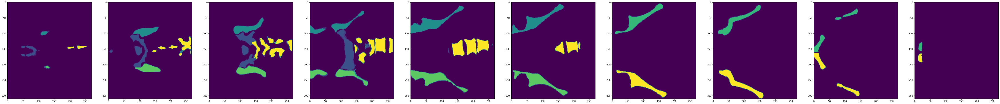

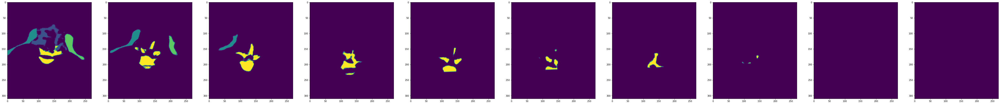

In [ ]:
class ArrayView(object):

    # xvalues: numpy 1D array of X values
    # functionToEvaluate should be in the form:
    # def gaussian(x, *args):
    #   m1, s1 = args
    #    ret = scipy.stats.norm.pdf(x, loc=m1, scale=s1) # x peut etre un array ici, pas forcement un scalaire
    #    return ret # renvoie un scalaire ou un array, suivant les cas
    # *functionArgs: function arguments
    # Example usage:
    # xvalues = np.linspace(-10.0, 10.0, 0.1)
    # yvalues = gaussian()
    # ArrayView.viewCurve(xvalues, yvalues)
    def viewCurve(xvalues, yvalues):
        plt.clf()
        plt.plot(xvalues, yvalues)

    def view2DArray(arr):
        plt.clf()
        plt.imshow(arr)
    
    # Ported from the Python2 code found in:
    # http://nbarbey.github.io/2011/07/08/matplotlib-slider.html
    # Changed:
    # xrange -> range
    # get rid of 'axisbg'
    # remove erroneous line breaks
    def view3DArray(cube, axis=1, **kwargs):
        # check dim
        if not cube.ndim == 4:
            raise ValueError("cube should be an ndarray with ndim == 4")

        if cube.shape[3] != 3:
            raise ValueError("cube's last dimension should be 3")
      
        minVal = np.min(cube)
        maxVal = np.max(cube)
    
        if minVal < 0.0 or maxVal > 1.0:
            raise ValueError("cube values cannot be outside the range [0,1]") 
        
        # generate figure
        fig = plt.figure()
        fig, (ax1, ax2 ,ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10) = plt.subplots(nrows=1, ncols=10, figsize=(80, 50))
        fig, (ax11, ax22 ,ax33, ax44, ax55, ax66, ax77, ax88, ax99, ax110) = plt.subplots(nrows=1, ncols=10, figsize=(80, 50))

        ax1.imshow(data[:, 20, :])
        ax2.imshow(data[:, 40, :])
        ax3.imshow(data[:, 60, :])
        ax4.imshow(data[:, 80, :])
        ax5.imshow(data[:, 100, :])
        ax6.imshow(data[:, 110, :])
        ax7.imshow(data[:, 120, :])
        ax8.imshow(data[:, 140, :])
        ax9.imshow(data[:, 160, :])
        ax10.imshow(data[:, 180, :])

        ax11.imshow(data_rotated[:, 20, :])
        ax22.imshow(data_rotated[:, 40, :])
        ax33.imshow(data_rotated[:, 60, :])
        ax44.imshow(data_rotated[:, 80, :])
        ax55.imshow(data_rotated[:, 100, :])
        ax66.imshow(data_rotated[:, 110, :])
        ax77.imshow(data_rotated[:, 120, :])
        ax88.imshow(data_rotated[:, 140, :])
        ax99.imshow(data_rotated[:, 160, :])
        ax110.imshow(data_rotated[:, 180, :])
        plt.show
        

if __name__ == "__main__":
 
    #reshape
    data = data.reshape(data.shape[0], data.shape[1], data.shape[2], 1)
    print(data.shape)
    data_cube = np.append( data , data , axis = 3)
    data_cube = np.append( data_cube,  data , axis = 3)
    print(data_cube.shape)


    #visualization 3D
    ArrayView.view3DArray(data_cube)

### Brightness

In [ ]:
def brightness(X):
    """
    Changing the brighness of a image using power-law gamma transformation.
    Gain and gamma are chosen randomly for each image channel.
    
    Gain chosen between [0.8 - 1.2]
    Gamma chosen between [0.8 - 1.2]
    
    new_im = gain * im^gamma
    """
    
    X_new = np.zeros(X.shape)
    for c in range(X.shape[-1]):
        im = X[:,:,:,c]        
        gain, gamma = (12.2 - 0.8) * np.random.random_sample(2,) + 0.8
        im_new = np.sign(im)*gain*(np.abs(im)**gamma)
        X_new[:,:,:,c] = im_new 
    
    return X_new

In [ ]:
data_bright = brightness(data)

(310, 188, 270, 1)
(310, 188, 270, 3)


<Figure size 432x288 with 0 Axes>

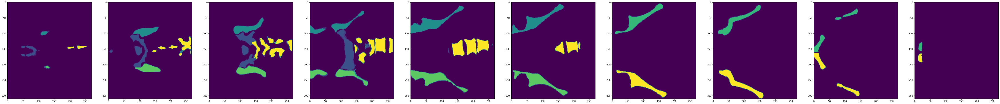

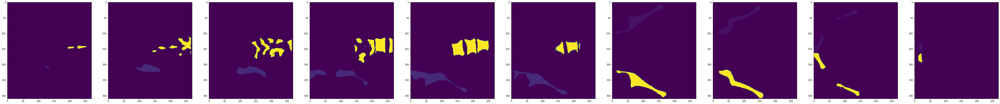

In [ ]:
class ArrayView(object):

    # xvalues: numpy 1D array of X values
    # functionToEvaluate should be in the form:
    # def gaussian(x, *args):
    #   m1, s1 = args
    #    ret = scipy.stats.norm.pdf(x, loc=m1, scale=s1) # x peut etre un array ici, pas forcement un scalaire
    #    return ret # renvoie un scalaire ou un array, suivant les cas
    # *functionArgs: function arguments
    # Example usage:
    # xvalues = np.linspace(-10.0, 10.0, 0.1)
    # yvalues = gaussian()
    # ArrayView.viewCurve(xvalues, yvalues)
    def viewCurve(xvalues, yvalues):
        plt.clf()
        plt.plot(xvalues, yvalues)

    def view2DArray(arr):
        plt.clf()
        plt.imshow(arr)
    
    # Ported from the Python2 code found in:
    # http://nbarbey.github.io/2011/07/08/matplotlib-slider.html
    # Changed:
    # xrange -> range
    # get rid of 'axisbg'
    # remove erroneous line breaks
    def view3DArray(cube, axis=1, **kwargs):
        # check dim
        if not cube.ndim == 4:
            raise ValueError("cube should be an ndarray with ndim == 4")

        if cube.shape[3] != 3:
            raise ValueError("cube's last dimension should be 3")
      
        minVal = np.min(cube)
        maxVal = np.max(cube)
    
        if minVal < 0.0 or maxVal > 1.0:
            raise ValueError("cube values cannot be outside the range [0,1]") 
        
        # generate figure
        fig = plt.figure()
        fig, (ax1, ax2 ,ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10) = plt.subplots(nrows=1, ncols=10, figsize=(80, 50))
        fig, (ax11, ax22 ,ax33, ax44, ax55, ax66, ax77, ax88, ax99, ax110) = plt.subplots(nrows=1, ncols=10, figsize=(80, 50))

        ax1.imshow(data[:, 20, :])
        ax2.imshow(data[:, 40, :])
        ax3.imshow(data[:, 60, :])
        ax4.imshow(data[:, 80, :])
        ax5.imshow(data[:, 100, :])
        ax6.imshow(data[:, 110, :])
        ax7.imshow(data[:, 120, :])
        ax8.imshow(data[:, 140, :])
        ax9.imshow(data[:, 160, :])
        ax10.imshow(data[:, 180, :])

        ax11.imshow(data_bright[:, 20, :])
        ax22.imshow(data_bright[:, 40, :])
        ax33.imshow(data_bright[:, 60, :])
        ax44.imshow(data_bright[:, 80, :])
        ax55.imshow(data_bright[:, 100, :])
        ax66.imshow(data_bright[:, 110, :])
        ax77.imshow(data_bright[:, 120, :])
        ax88.imshow(data_bright[:, 140, :])
        ax99.imshow(data_bright[:, 160, :])
        ax110.imshow(data_bright[:, 180, :])
        plt.show
        

if __name__ == "__main__":
 
    #reshape
    data = data.reshape(data.shape[0], data.shape[1], data.shape[2], 1)
    print(data.shape)
    data_cube = np.append( data , data , axis = 3)
    data_cube = np.append( data_cube,  data , axis = 3)
    print(data_cube.shape)

    """data_flipped = data_flipped.reshape(data.shape[0], data.shape[1], data.shape[2], 1)
    data_flipped_cube = np.append( data_flipped , data_flipped , axis = 3)
    data_flipped_cube = np.append( data_flipped_cube,  data_flipped , axis = 3)
    print(data_flipped_cube.shape)"""


    #visualization 3D
    ArrayView.view3DArray(data_cube)